In [2]:
print("Hello, World!")

Hello, World!


In [ ]:
import pandas as pd
pd.set_option('display.max_rows', None)   # 顯示所有列
pd.set_option('display.max_columns', None)  # 顯示所有欄
pd.set_option('display.max_colwidth', None) # 顯示完整欄位內容

# dictionary 轉 dataframe

In [4]:
ohlc = {
    "open": [1, 2, 3, 4],
    "close": [2, 3, 4, 5]
}
df = pd.DataFrame(ohlc)
# 屬性
print(df.columns)
# 方法(資料結構裡面的函數)
print(df.max())

Index(['open', 'close'], dtype='object')
open     4
close    5
dtype: int64


# list 轉 dataframe

In [5]:
ohlc = [
    [1, 2, 3, 4],
    [2, 3, 4, 5]
]
pd.DataFrame(ohlc)

,0,1,2,3
0,1,2,3,4
1,2,3,4,5


# 常見屬性

In [6]:
df

,open,close
0,1,2
1,2,3
2,3,4
3,4,5


In [7]:
print("維度", df.ndim)
print("面積", df.shape)
print("資料型態\n", df.dtypes)
print("資料欄位\n", df.columns)
print("資料欄位結果轉成list\n", df.columns.to_list())
print("資料索引\n", df.index)

維度 2
面積 (4, 2)
資料型態
 open     int64
close    int64
dtype: object
資料欄位
 Index(['open', 'close'], dtype='object')
資料欄位結果轉成list
 ['open', 'close']
資料索引
 RangeIndex(start=0, stop=4, step=1)


In [8]:
print(df["open"])
print(type(df["open"]))
print(type(df))
print(df.open) # 少用

0    1
1    2
2    3
3    4
Name: open, dtype: int64
<class 'pandas.core.series.Series'>
<class 'pandas.core.frame.DataFrame'>
0    1
1    2
2    3
3    4
Name: open, dtype: int64


In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4 entries, 0 to 3
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   open    4 non-null      int64
 1   close   4 non-null      int64
dtypes: int64(2)
memory usage: 196.0 bytes


In [10]:
df.describe()
df.describe([.1, .2, .3, .9])

,open,close
count,4.000000,4.000000
mean,2.500000,3.500000
std,1.290994,1.290994
min,1.000000,2.000000
10%,1.300000,2.300000
20%,1.600000,2.600000
30%,1.900000,2.900000
50%,2.500000,3.500000
90%,3.700000,4.700000
max,4.000000,5.000000


In [11]:
print(df)
print(df.mean())
print(df.mean(axis=0))  # axis=0 代表直向計算
print(df.mean(axis=1))  # axis=1 代表橫向計算

   open  close
0     1      2
1     2      3
2     3      4
3     4      5
open     2.5
close    3.5
dtype: float64
open     2.5
close    3.5
dtype: float64
0    1.5
1    2.5
2    3.5
3    4.5
dtype: float64


In [12]:
print(f"df['open'].sum(): {df['open'].sum()}\n")
print(f"df['open'].median(): {df['open'].median()}\n")
print(f"df['open'].mode(): {df['open'].mode()}\n")

df['open'].sum(): 10

df['open'].median(): 2.5

df['open'].mode(): 0    1
1    2
2    3
3    4
Name: open, dtype: int64



In [13]:
print(f"df['open'].std(): {df['open'].std()}\n")
print(f"df['open'].abs(): {df['open'].abs()}\n")
print(f"df['open'].prod(): {df['open'].prod()}\n")

df['open'].std(): 1.2909944487358056

df['open'].abs(): 0    1
1    2
2    3
3    4
Name: open, dtype: int64

df['open'].prod(): 24



In [14]:
print(df["open"].sum())
print(df["open"].cumsum())
df["open_cumsum"] = df["open"].cumsum()
df['open_cumprod'] = df['open'].cumprod()
print(df)

10
0     1
1     3
2     6
3    10
Name: open, dtype: int64
   open  close  open_cumsum  open_cumprod
0     1      2            1             1
1     2      3            3             2
2     3      4            6             6
3     4      5           10            24


In [15]:
print(df['open'].quantile([.5, .3]))
print(df.cov())
print(df.corr())
print(df.diff())
print(df.pct_change())

0.5    2.5
0.3    1.9
Name: open, dtype: float64
                   open      close  open_cumsum  open_cumprod
open           1.666667   1.666667     5.000000     12.166667
close          1.666667   1.666667     5.000000     12.166667
open_cumsum    5.000000   5.000000    15.333333     39.333333
open_cumprod  12.166667  12.166667    39.333333    114.916667
                  open     close  open_cumsum  open_cumprod
open          1.000000  1.000000     0.989071      0.879135
close         1.000000  1.000000     0.989071      0.879135
open_cumsum   0.989071  0.989071     1.000000      0.937025
open_cumprod  0.879135  0.879135     0.937025      1.000000
   open  close  open_cumsum  open_cumprod
0   NaN    NaN          NaN           NaN
1   1.0    1.0          2.0           1.0
2   1.0    1.0          3.0           4.0
3   1.0    1.0          4.0          18.0
       open     close  open_cumsum  open_cumprod
0       NaN       NaN          NaN           NaN
1  1.000000  0.500000     2.00000

In [16]:
# df.loc[index, column]
print(df, '\n')
print(df.loc[2, 'open_cumsum'], '\n')
print(df.loc[3, 'open'], '\n')
print(df.loc[0:2, 'open'], '\n')
print(df.loc[1:, 'open'], '\n')
print(df.loc[:1, 'open'], '\n')
print(df.loc[:1, ['open', 'close']], '\n')


   open  close  open_cumsum  open_cumprod
0     1      2            1             1
1     2      3            3             2
2     3      4            6             6
3     4      5           10            24 

6 

4 

0    1
1    2
2    3
Name: open, dtype: int64 

1    2
2    3
3    4
Name: open, dtype: int64 

0    1
1    2
Name: open, dtype: int64 

   open  close
0     1      2
1     2      3 



In [17]:
# df.iloc[index int, column int]
print(df, '\n')
print(df.iloc[1:], '\n')
print(df.iloc[:-2], '\n')
print(df.iloc[:-2, 1], '\n')
print(df.iloc[:-2, 3], '\n')

   open  close  open_cumsum  open_cumprod
0     1      2            1             1
1     2      3            3             2
2     3      4            6             6
3     4      5           10            24 

   open  close  open_cumsum  open_cumprod
1     2      3            3             2
2     3      4            6             6
3     4      5           10            24 

   open  close  open_cumsum  open_cumprod
0     1      2            1             1
1     2      3            3             2 

0    2
1    3
Name: close, dtype: int64 

0    1
1    2
Name: open_cumprod, dtype: int64 



# 能否針對df透過迴圈與loc將所有資料逐一檢視

In [18]:
print(df, '\n')
for ind in df.index:
    print(ind)
    for col in df.columns:
        # print(col)
        print(ind, col, df.loc[ind, col])

   open  close  open_cumsum  open_cumprod
0     1      2            1             1
1     2      3            3             2
2     3      4            6             6
3     4      5           10            24 

0
0 open 1
0 close 2
0 open_cumsum 1
0 open_cumprod 1
1
1 open 2
1 close 3
1 open_cumsum 3
1 open_cumprod 2
2
2 open 3
2 close 4
2 open_cumsum 6
2 open_cumprod 6
3
3 open 4
3 close 5
3 open_cumsum 10
3 open_cumprod 24


In [19]:
print(df, '\n')

# 改成使用iloc
for i in range(df.shape[0]):  # 0~3
    # print(i)
    for j in range(df.shape[1]):  # 0~3
        # print(j)
        print(i, j, df.iloc[i, j])

   open  close  open_cumsum  open_cumprod
0     1      2            1             1
1     2      3            3             2
2     3      4            6             6
3     4      5           10            24 

0 0 1
0 1 2
0 2 1
0 3 1
1 0 2
1 1 3
1 2 3
1 3 2
2 0 3
2 1 4
2 2 6
2 3 6
3 0 4
3 1 5
3 2 10
3 3 24


In [20]:
print(df, '\n')

# 改使用iloc，使用range + len
for i in range(len(df.index)):
    # print(i)
    for j in range(len(df.columns)):
        print(i, j, df.iloc[i, j])

   open  close  open_cumsum  open_cumprod
0     1      2            1             1
1     2      3            3             2
2     3      4            6             6
3     4      5           10            24 

0 0 1
0 1 2
0 2 1
0 3 1
1 0 2
1 1 3
1 2 3
1 3 2
2 0 3
2 1 4
2 2 6
2 3 6
3 0 4
3 1 5
3 2 10
3 3 24


In [21]:
df['new_col'] = [100, 101, 102, 103]
df['new_col2'] = df['open']
df

,open,close,open_cumsum,open_cumprod,new_col,new_col2
0,1,2,1,1,100,1
1,2,3,3,2,101,2
2,3,4,6,6,102,3
3,4,5,10,24,103,4


In [22]:
# df.drop(columns=['new_col2']) # 把刪掉欄位的結果回傳
# df.drop(columns=['new_col2'], inplace=True)  # 直接在原本的df刪掉欄位
df = df.drop(columns='new_col2')  # 把刪掉欄位的結果回傳並覆蓋原本的df
df

,open,close,open_cumsum,open_cumprod,new_col
0,1,2,1,1,100
1,2,3,3,2,101
2,3,4,6,6,102
3,4,5,10,24,103


In [23]:
df.loc[4] = [1, 2, 3, 4, 5]
df.loc[100] = [1, 2, 3, 4, 100]
df

,open,close,open_cumsum,open_cumprod,new_col
0,1,2,1,1,100
1,2,3,3,2,101
2,3,4,6,6,102
3,4,5,10,24,103
4,1,2,3,4,5
100,1,2,3,4,100


In [24]:
# df = df.drop(index=100)
df.drop(index=100, inplace=True)
df

,open,close,open_cumsum,open_cumprod,new_col
0,1,2,1,1,100
1,2,3,3,2,101
2,3,4,6,6,102
3,4,5,10,24,103
4,1,2,3,4,5


# 抓取公開數據

In [25]:
# pip install yfinance

In [26]:
import yfinance as yf

In [27]:
tk = yf.Ticker("GOOG")
tk.info
tk.calendar
tk.analyst_price_targets
tk.quarterly_income_stmt
tk.history(period="1mo")
tk.option_chain(tk.options[0]).calls

,contractSymbol,lastTradeDate,strike,lastPrice,bid,ask,change,percentChange,volume,openInterest,impliedVolatility,inTheMoney,contractSize,currency
0,GOOG251121C00075000,2025-11-19 20:49:30+00:00,75.0,221.55,0.0,0.0,0.0,0.0,10.0,0,0.000010,True,REGULAR,USD
1,GOOG251121C00080000,2025-11-19 20:49:30+00:00,80.0,216.60,0.0,0.0,0.0,0.0,11.0,0,0.000010,True,REGULAR,USD
2,GOOG251121C00085000,2025-11-17 15:42:27+00:00,85.0,205.62,0.0,0.0,0.0,0.0,2.0,0,0.000010,True,REGULAR,USD
3,GOOG251121C00090000,2025-11-19 14:39:54+00:00,90.0,207.36,0.0,0.0,0.0,0.0,1.0,0,0.000010,True,REGULAR,USD
4,GOOG251121C00095000,2025-11-19 14:40:58+00:00,95.0,203.45,0.0,0.0,0.0,0.0,1.0,0,0.000010,True,REGULAR,USD
5,GOOG251121C00100000,2025-11-19 14:46:11+00:00,100.0,201.35,0.0,0.0,0.0,0.0,7.0,0,0.000010,True,REGULAR,USD
6,GOOG251121C00105000,2025-11-19 14:46:11+00:00,105.0,196.40,0.0,0.0,0.0,0.0,8.0,0,0.000010,True,REGULAR,USD
7,GOOG251121C00110000,2025-11-17 15:45:10+00:00,110.0,181.78,0.0,0.0,0.0,0.0,1.0,0,0.000010,True,REGULAR,USD
8,GOOG251121C00115000,2025-11-18 17:01:00+00:00,115.0,172.30,0.0,0.0,0.0,0.0,11.0,0,0.000010,True,REGULAR,USD
9,GOOG251121C00120000,2025-11-17 15:49:07+00:00,120.0,170.96,0.0,0.0,0.0,0.0,2.0,0,0.000010,True,REGULAR,USD


In [28]:
df = yf.download("0050.TW")
df

C:\Users\TaiLei\AppData\Local\Temp\ipykernel_13892\415483722.py:1: FutureWarning: YF.download() has changed argument auto_adjust default to True
  df = yf.download("0050.TW")
[*********************100%***********************]  1 of 1 completed


Price,Close,High,Low,Open,Volume
Ticker,0050.TW,0050.TW,0050.TW,0050.TW,0050.TW
Date,,,,,
2025-10-20,63.099998,63.200001,62.150002,62.349998,102880277
2025-10-21,63.200001,63.650002,63.049999,63.400002,124931191
2025-10-22,62.700001,62.849998,62.250000,62.599998,116660310
2025-10-23,62.349998,62.400002,61.750000,62.099998,161355781
2025-10-27,63.799999,63.900002,63.450001,63.750000,102297434
2025-10-28,63.349998,63.700001,63.200001,63.549999,93730892
2025-10-29,64.400002,64.449997,63.700001,63.700001,65206490
2025-10-30,64.400002,64.800003,64.000000,64.599998,91073965


In [29]:
print(df['Close'].mean()) # 印出收盤價的平均值
print(df['Volume'].sum()) # 印出成交量的總和
print(df['Volume'].cumsum()) # 印出成交量的累積和
print(df['Close'].diff()) # 印出收盤價的日變化
print(df['Close'].pct_change()) # 印出收盤價的日百分比變化

Ticker
0050.TW    62.930435
dtype: float64
Ticker
0050.TW    2465232902
dtype: int64
Ticker         0050.TW
Date                  
2025-10-20   102880277
2025-10-21   227811468
2025-10-22   344471778
2025-10-23   505827559
2025-10-27   608124993
2025-10-28   701855885
2025-10-29   767062375
2025-10-30   858136340
2025-10-31   911766264
2025-11-03  1042405050
2025-11-04  1125523831
2025-11-05  1336521730
2025-11-06  1402081643
2025-11-07  1504540231
2025-11-10  1584796977
2025-11-11  1660179926
2025-11-12  1720002119
2025-11-13  1794965752
2025-11-14  1999073774
2025-11-17  2086001587
2025-11-18  2326527817
2025-11-19  2465232902
2025-11-20  2465232902
Ticker       0050.TW
Date                
2025-10-20       NaN
2025-10-21  0.100002
2025-10-22 -0.500000
2025-10-23 -0.350002
2025-10-27  1.450001
2025-10-28 -0.450001
2025-10-29  1.050003
2025-10-30  0.000000
2025-10-31  0.349998
2025-11-03 -0.599998
2025-11-04 -0.200001
2025-11-05 -0.799999
2025-11-06  0.149998
2025-11-07 -0.750000
2025

In [30]:
# 實作練習: 每日的(開盤 + 收盤) / 2
# print((df['Open'] + df['Close']) / 2) # 向量化計算
print(df['Open'] + 10)

Ticker        0050.TW
Date                 
2025-10-20  72.349998
2025-10-21  73.400002
2025-10-22  72.599998
2025-10-23  72.099998
2025-10-27  73.750000
2025-10-28  73.549999
2025-10-29  73.700001
2025-10-30  74.599998
2025-10-31  74.599998
2025-11-03  74.449997
2025-11-04  74.500000
2025-11-05  72.950001
2025-11-06  73.349998
2025-11-07  72.650002
2025-11-10  72.799999
2025-11-11  73.650002
2025-11-12  72.950001
2025-11-13  72.799999
2025-11-14  71.650002
2025-11-17  72.000000
2025-11-18  71.299999
2025-11-19  70.150002
2025-11-20  71.799999


In [31]:
# df.info()
# df.loc['2025-10-27']
# df.loc['2025-10']
# df.loc['2025-10-20':'2025-10-30']
# df.loc['2025-10-20':'2025-10-30' , 'Open']
df.iloc[:10 , 1] # 資料前10列，第2欄(第2個column)

Date
2025-10-20    63.200001
2025-10-21    63.650002
2025-10-22    62.849998
2025-10-23    62.400002
2025-10-27    63.900002
2025-10-28    63.700001
2025-10-29    64.449997
2025-10-30    64.800003
2025-10-31    64.800003
2025-11-03    64.800003
Name: (High, 0050.TW), dtype: float64

In [32]:
# 請抓出近5天的收盤價(Close)，並且算出平均值
print(df.iloc[-5:, 0])
print(df.iloc[-5:, 0].mean())

print((df.iloc[-5:]['Close']).mean())

Date
2025-11-14    61.700001
2025-11-17    61.900002
2025-11-18    60.450001
2025-11-19    60.049999
2025-11-20    61.799999
Name: (Close, 0050.TW), dtype: float64
61.18000030517578
Ticker
0050.TW    61.18
dtype: float64


In [33]:
df['OpenADJ'] = df['Open'] * 2 / 3
df = df.drop(columns=['OpenADJ'])

df.drop(index='2025-10-20')
df.loc['2025-09-01'] = [1, 2, 3, 4, 5]
df

Price,Close,High,Low,Open,Volume
Ticker,0050.TW,0050.TW,0050.TW,0050.TW,0050.TW
Date,,,,,
2025-10-20 00:00:00,63.099998,63.200001,62.150002,62.349998,102880277
2025-10-21 00:00:00,63.200001,63.650002,63.049999,63.400002,124931191
2025-10-22 00:00:00,62.700001,62.849998,62.250000,62.599998,116660310
2025-10-23 00:00:00,62.349998,62.400002,61.750000,62.099998,161355781
2025-10-27 00:00:00,63.799999,63.900002,63.450001,63.750000,102297434
2025-10-28 00:00:00,63.349998,63.700001,63.200001,63.549999,93730892
2025-10-29 00:00:00,64.400002,64.449997,63.700001,63.700001,65206490
2025-10-30 00:00:00,64.400002,64.800003,64.000000,64.599998,91073965


In [34]:
df = yf.download("0050.TW", start='1993-01-01')

C:\Users\TaiLei\AppData\Local\Temp\ipykernel_13892\3067349339.py:1: FutureWarning: YF.download() has changed argument auto_adjust default to True
  df = yf.download("0050.TW", start='1993-01-01')
[*********************100%***********************]  1 of 1 completed


In [35]:
df.isna()

Price,Close,High,Low,Open,Volume
Ticker,0050.TW,0050.TW,0050.TW,0050.TW,0050.TW
Date,,,,,
2009-01-02,False,False,False,False,False
2009-01-05,False,False,False,False,False
2009-01-06,False,False,False,False,False
2009-01-07,False,False,False,False,False
2009-01-08,False,False,False,False,False
2009-01-09,False,False,False,False,False
2009-01-12,False,False,False,False,False
2009-01-13,False,False,False,False,False


In [36]:
import pandas as pd
# 創建 DataFrame
df = pd.DataFrame({
    'A': [1, 2, None, 4],
    'B': [5, None, 7, 8],
    'C': [9, 10, 11, 12]
})

# 判斷 DataFrame 中的缺失值
print(df)
print(df.isna())
print(df.isna().loc[2, 'B'])  # 檢查特定位置是否為缺失值

     A    B   C
0  1.0  5.0   9
1  2.0  NaN  10
2  NaN  7.0  11
3  4.0  8.0  12
       A      B      C
0  False  False  False
1  False   True  False
2   True  False  False
3  False  False  False
False


In [37]:
print(df.dropna()) # 刪除含有缺失值的列
print(df.dropna(axis=0)) # 刪除含有缺失值的列
print(df.dropna(axis=1)) # 刪除含有缺失值的欄
print(df.dropna(subset='B')) # 刪除在欄B中含有缺失值的列

     A    B   C
0  1.0  5.0   9
3  4.0  8.0  12
     A    B   C
0  1.0  5.0   9
3  4.0  8.0  12
    C
0   9
1  10
2  11
3  12
     A    B   C
0  1.0  5.0   9
2  NaN  7.0  11
3  4.0  8.0  12


In [38]:
print(df.fillna(0))  # 用0填補缺失值
print(df.fillna(df.mean())) # 用各欄的平均值填補缺失值
print(df.ffill()) # 用前一個有效值填補缺失值
print(df.bfill()) # 用後一個有效值填補缺失值

     A    B   C
0  1.0  5.0   9
1  2.0  0.0  10
2  0.0  7.0  11
3  4.0  8.0  12
          A         B   C
0  1.000000  5.000000   9
1  2.000000  6.666667  10
2  2.333333  7.000000  11
3  4.000000  8.000000  12
     A    B   C
0  1.0  5.0   9
1  2.0  5.0  10
2  2.0  7.0  11
3  4.0  8.0  12
     A    B   C
0  1.0  5.0   9
1  2.0  7.0  10
2  4.0  7.0  11
3  4.0  8.0  12


In [39]:
df = yf.download("0050.TW", start='1993-01-01')

C:\Users\TaiLei\AppData\Local\Temp\ipykernel_13892\3067349339.py:1: FutureWarning: YF.download() has changed argument auto_adjust default to True
  df = yf.download("0050.TW", start='1993-01-01')
[*********************100%***********************]  1 of 1 completed


In [40]:
df[df.duplicated()] # 列出重複值
df.drop_duplicates() # 刪除重複值

Price,Close,High,Low,Open,Volume
Ticker,0050.TW,0050.TW,0050.TW,0050.TW,0050.TW
Date,,,,,
2009-01-02,20.756758,20.756758,20.756758,20.756758,0
2009-01-05,23.105860,23.105860,19.304349,22.209157,26338
2009-01-06,23.093233,23.105863,21.426126,23.105863,24377
2009-01-07,20.339977,22.019715,20.339977,21.912364,16672
2009-01-08,19.045444,21.350348,19.045444,21.217736,31357
2009-01-09,20.346296,20.535740,20.220000,20.478907,18391
2009-01-12,21.590309,21.590309,19.954776,19.973720,13977
2009-01-13,20.624147,21.590312,19.992667,21.590312,11554


In [41]:
cond = (df['Open'] > 40)
df[cond]

Price,Close,High,Low,Open,Volume
Ticker,0050.TW,0050.TW,0050.TW,0050.TW,0050.TW
Date,,,,,
2009-01-02,NaN,NaN,NaN,NaN,NaN
2009-01-05,NaN,NaN,NaN,NaN,NaN
2009-01-06,NaN,NaN,NaN,NaN,NaN
2009-01-07,NaN,NaN,NaN,NaN,NaN
2009-01-08,NaN,NaN,NaN,NaN,NaN
2009-01-09,NaN,NaN,NaN,NaN,NaN
2009-01-12,NaN,NaN,NaN,NaN,NaN
2009-01-13,NaN,NaN,NaN,NaN,NaN


In [42]:
# 抓出「成交量 > 平均數」的日期資料
mean_volume = df['Volume'].mean()
filtered_df = df[df['Volume'] > mean_volume]
print(filtered_df)

Price           Close       High        Low       Open       Volume
Ticker        0050.TW    0050.TW    0050.TW    0050.TW      0050.TW
Date                                                               
2009-01-02        NaN        NaN        NaN        NaN          NaN
2009-01-05        NaN        NaN        NaN        NaN          NaN
2009-01-06        NaN        NaN        NaN        NaN          NaN
2009-01-07        NaN        NaN        NaN        NaN          NaN
2009-01-08        NaN        NaN        NaN        NaN          NaN
2009-01-09        NaN        NaN        NaN        NaN          NaN
2009-01-12        NaN        NaN        NaN        NaN          NaN
2009-01-13        NaN        NaN        NaN        NaN          NaN
2009-01-14        NaN        NaN        NaN        NaN          NaN
2009-01-15        NaN        NaN        NaN        NaN          NaN
2009-01-16        NaN        NaN        NaN        NaN          NaN
2009-01-19        NaN        NaN        NaN     

In [43]:
df.columns = df.columns.get_level_values(0) # 取消多層欄位名稱

In [44]:
cond = (df['Open'] > 40)
cond2 = df['Volume'] > 20000000
# df[cond]
df[cond&cond2] # & = and
df[cond|cond2] # | = or

Price,Close,High,Low,Open,Volume
Date,,,,,
2012-01-04,31.574013,31.668736,31.435086,31.510866,23080541
2012-01-05,31.668737,31.668737,31.517181,31.637161,21097923
2012-01-06,31.574013,31.731883,31.479290,31.637160,28343880
2012-01-10,32.016048,32.016048,31.700308,31.700308,29305530
2012-01-13,32.110767,32.363360,32.047620,32.300213,39263092
2012-01-16,31.605585,32.268639,31.416142,32.237065,28879651
2012-05-07,32.868542,33.121135,32.742245,33.121135,21312453
2012-05-09,32.647530,32.742250,32.426510,32.615956,22880792
2012-05-11,32.300224,32.584389,32.237075,32.584389,29045919


In [45]:
# df.sort_values('Volume') # 按成交量排序
# df.sort_values('Volume', ascending=True) # 由小到大排序
df.sort_values('Volume', ascending=False) # 由大到小排序


Price,Close,High,Low,Open,Volume
Date,,,,,
2025-04-08,38.044422,39.087074,37.374146,37.535507,321307308
2025-04-09,36.294254,38.267847,35.996354,37.858235,300494796
2018-10-11,15.414686,15.962366,15.404728,15.962366,274206496
2020-03-19,14.656744,15.180580,14.378789,15.180580,272153360
2025-10-13,61.000000,61.000000,59.599998,59.900002,261787970
2024-08-06,41.015114,41.725225,39.374510,40.966141,252563844
2015-08-24,10.270064,10.555840,9.894984,10.555840,245269636
2025-06-18,47.237148,47.386100,46.810157,47.167638,244697327
2025-11-18,60.450001,61.299999,60.299999,61.299999,240526230


In [46]:
# df['Volume_rank'] = df['Volume'].rank()
# df[df['Volume_rank'] == df['Volume_rank'].max()] # 找出成交量最低的日期

# df['Volume_rank'] = df['Volume'].rank(ascending=False)
# df[df['Volume_rank'] == df['Volume_rank'].min()] # 找出成交量最高的日期

df['Volume_rank'] = df['Volume'].rank(pct=True) # 百分比排名
df[df['Volume_rank'] == df['Volume_rank'].max()] # 

Price,Close,High,Low,Open,Volume,Volume_rank
Date,,,,,,
2025-04-08,38.044422,39.087074,37.374146,37.535507,321307308,1.0


In [47]:
df['Open'].astype(str).astype(float) # 轉換資料型態

pd.to_numeric(df['Open']) # 轉換資料型態

Date
2009-01-02    20.756758
2009-01-05    22.209157
2009-01-06    23.105863
2009-01-07    21.912364
2009-01-08    21.217736
2009-01-09    20.478907
2009-01-12    19.973720
2009-01-13    21.590312
2009-01-14    20.624148
2009-01-15    21.956566
2009-01-16    19.702185
2009-01-19    19.860059
2009-01-20    19.342242
2009-01-21    19.196999
2009-02-02    19.196999
2009-02-03    19.399074
2009-02-04    18.483431
2009-02-05    21.407187
2009-02-06    20.062131
2009-02-09    18.912837
2009-02-10    20.554684
2009-02-11    22.089184
2009-02-12    20.920945
2009-02-13    21.855535
2009-02-16    21.015664
2009-02-17    22.436494
2009-02-18    19.575889
2009-02-19    20.321035
2009-02-20    20.396813
2009-02-23    21.685033
2009-02-24    20.081073
2009-02-25    20.523109
2009-02-26    20.674662
2009-02-27    19.266467
2009-03-02    22.329144
2009-03-03    21.571367
2009-03-04    18.767595
2009-03-05    22.127064
2009-03-06    19.645354
2009-03-09    21.280885
2009-03-10    22.512268
2009-03-11 

In [48]:
df['cut'] = pd.cut(df['Open'], bins=[10, 20, 35, 40, 60, 100]) # 根據指定的區間進行分箱
df

df['qcut'] = pd.qcut(df['Open'], q=8) # 根據資料分成8等份
df

Price,Close,High,Low,Open,Volume,Volume_rank,cut,qcut
Date,,,,,,,,
2009-01-02,20.756758,20.756758,20.756758,20.756758,0,0.002056,"(20.0, 35.0]","(19.382, 28.544]"
2009-01-05,23.105860,23.105860,19.304349,22.209157,26338,0.176058,"(20.0, 35.0]","(19.382, 28.544]"
2009-01-06,23.093233,23.105863,21.426126,23.105863,24377,0.172430,"(20.0, 35.0]","(19.382, 28.544]"
2009-01-07,20.339977,22.019715,20.339977,21.912364,16672,0.138331,"(20.0, 35.0]","(19.382, 28.544]"
2009-01-08,19.045444,21.350348,19.045444,21.217736,31357,0.184764,"(20.0, 35.0]","(19.382, 28.544]"
2009-01-09,20.346296,20.535740,20.220000,20.478907,18391,0.148730,"(20.0, 35.0]","(19.382, 28.544]"
2009-01-12,21.590309,21.590309,19.954776,19.973720,13977,0.118259,"(10.0, 20.0]","(19.382, 28.544]"
2009-01-13,20.624147,21.590312,19.992667,21.590312,11554,0.090931,"(20.0, 35.0]","(19.382, 28.544]"
2009-01-14,21.956572,21.956572,20.516797,20.624148,13520,0.113422,"(20.0, 35.0]","(19.382, 28.544]"


In [49]:
df.to_csv('20251118_data.csv') # 儲存成CSV檔

In [50]:
df['中文'] = '我'
# df.to_csv('20251118_data_with_chinese.csv') # 用預設的python編碼有可能會無法顯示中文
df.to_csv('20251118_data_with_chinese.csv', encoding='cp950') # 用cp950，為Windows可以接受的編碼
df

Price,Close,High,Low,Open,Volume,Volume_rank,cut,qcut,中文
Date,,,,,,,,,
2009-01-02,20.756758,20.756758,20.756758,20.756758,0,0.002056,"(20.0, 35.0]","(19.382, 28.544]",我
2009-01-05,23.105860,23.105860,19.304349,22.209157,26338,0.176058,"(20.0, 35.0]","(19.382, 28.544]",我
2009-01-06,23.093233,23.105863,21.426126,23.105863,24377,0.172430,"(20.0, 35.0]","(19.382, 28.544]",我
2009-01-07,20.339977,22.019715,20.339977,21.912364,16672,0.138331,"(20.0, 35.0]","(19.382, 28.544]",我
2009-01-08,19.045444,21.350348,19.045444,21.217736,31357,0.184764,"(20.0, 35.0]","(19.382, 28.544]",我
2009-01-09,20.346296,20.535740,20.220000,20.478907,18391,0.148730,"(20.0, 35.0]","(19.382, 28.544]",我
2009-01-12,21.590309,21.590309,19.954776,19.973720,13977,0.118259,"(10.0, 20.0]","(19.382, 28.544]",我
2009-01-13,20.624147,21.590312,19.992667,21.590312,11554,0.090931,"(20.0, 35.0]","(19.382, 28.544]",我
2009-01-14,21.956572,21.956572,20.516797,20.624148,13520,0.113422,"(20.0, 35.0]","(19.382, 28.544]",我


In [51]:
df1 = pd.read_csv('20251118_data_with_chinese.csv', encoding='cp950')
df1

,Date,Close,High,Low,Open,Volume,Volume_rank,cut,qcut,中文
0,2009-01-02,20.756758,20.756758,20.756758,20.756758,0,0.002056,"(20, 35]","(19.382, 28.544]",我
1,2009-01-05,23.105860,23.105860,19.304349,22.209157,26338,0.176058,"(20, 35]","(19.382, 28.544]",我
2,2009-01-06,23.093233,23.105863,21.426126,23.105863,24377,0.172430,"(20, 35]","(19.382, 28.544]",我
3,2009-01-07,20.339977,22.019715,20.339977,21.912364,16672,0.138331,"(20, 35]","(19.382, 28.544]",我
4,2009-01-08,19.045444,21.350348,19.045444,21.217736,31357,0.184764,"(20, 35]","(19.382, 28.544]",我
5,2009-01-09,20.346296,20.535740,20.220000,20.478907,18391,0.148730,"(20, 35]","(19.382, 28.544]",我
6,2009-01-12,21.590309,21.590309,19.954776,19.973720,13977,0.118259,"(10, 20]","(19.382, 28.544]",我
7,2009-01-13,20.624147,21.590312,19.992667,21.590312,11554,0.090931,"(20, 35]","(19.382, 28.544]",我
8,2009-01-14,21.956572,21.956572,20.516797,20.624148,13520,0.113422,"(20, 35]","(19.382, 28.544]",我
9,2009-01-15,19.575886,21.956566,19.544312,21.956566,29872,0.182830,"(20, 35]","(19.382, 28.544]",我


In [52]:
# pip install openpyxl

In [53]:
df.to_excel('20251118_data_with_chinese.xlsx') # 儲存成Excel檔

In [54]:
pd.read_excel('20251118_data_with_chinese.xlsx')

,Date,Close,High,Low,Open,Volume,Volume_rank,cut,qcut,中文
0,2009-01-02,20.756758,20.756758,20.756758,20.756758,0,0.002056,"(20.0, 35.0]","(19.382, 28.544]",我
1,2009-01-05,23.105860,23.105860,19.304349,22.209157,26338,0.176058,"(20.0, 35.0]","(19.382, 28.544]",我
2,2009-01-06,23.093233,23.105863,21.426126,23.105863,24377,0.172430,"(20.0, 35.0]","(19.382, 28.544]",我
3,2009-01-07,20.339977,22.019715,20.339977,21.912364,16672,0.138331,"(20.0, 35.0]","(19.382, 28.544]",我
4,2009-01-08,19.045444,21.350348,19.045444,21.217736,31357,0.184764,"(20.0, 35.0]","(19.382, 28.544]",我
5,2009-01-09,20.346296,20.535740,20.220000,20.478907,18391,0.148730,"(20.0, 35.0]","(19.382, 28.544]",我
6,2009-01-12,21.590309,21.590309,19.954776,19.973720,13977,0.118259,"(10.0, 20.0]","(19.382, 28.544]",我
7,2009-01-13,20.624147,21.590312,19.992667,21.590312,11554,0.090931,"(20.0, 35.0]","(19.382, 28.544]",我
8,2009-01-14,21.956572,21.956572,20.516797,20.624148,13520,0.113422,"(20.0, 35.0]","(19.382, 28.544]",我
9,2009-01-15,19.575886,21.956566,19.544312,21.956566,29872,0.182830,"(20.0, 35.0]","(19.382, 28.544]",我


In [55]:
# pip install matplotlib

Date
2009-01-02    20.756758
2009-01-05    23.105860
2009-01-06    23.093233
2009-01-07    20.339977
2009-01-08    19.045444
2009-01-09    20.346296
2009-01-12    21.590309
2009-01-13    20.624147
2009-01-14    21.956572
2009-01-15    19.575886
2009-01-16    18.944408
2009-01-19    21.299833
2009-01-20    20.737814
2009-01-21    19.260147
2009-02-02    20.864107
2009-02-03    19.872684
2009-02-04    20.011614
2009-02-05    19.847429
2009-02-06    20.333668
2009-02-09    21.956572
2009-02-10    22.089182
2009-02-11    19.531689
2009-02-12    21.855536
2009-02-13    21.015665
2009-02-16    22.436495
2009-02-17    20.485220
2009-02-18    19.083334
2009-02-19    22.240736
2009-02-20    21.685034
2009-02-23    20.485220
2009-02-24    21.729237
2009-02-25    20.674665
2009-02-26    20.712549
2009-02-27    20.870426
2009-03-02    20.163166
2009-03-03    20.175797
2009-03-04    20.680981
2009-03-05    21.123011
2009-03-06    22.745922
2009-03-09    21.040922
2009-03-10    21.141954
2009-03-11 

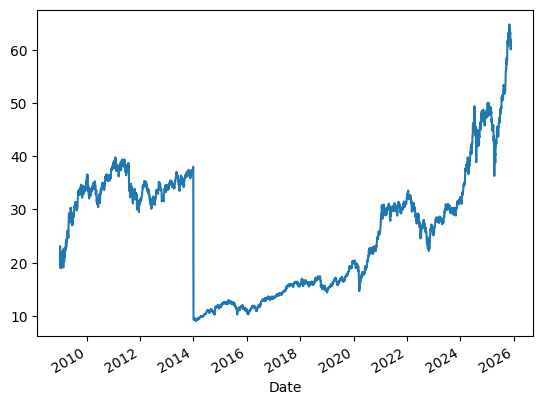

In [56]:
df['Close'].plot()
df['Close']

<Axes: ylabel='Frequency'>

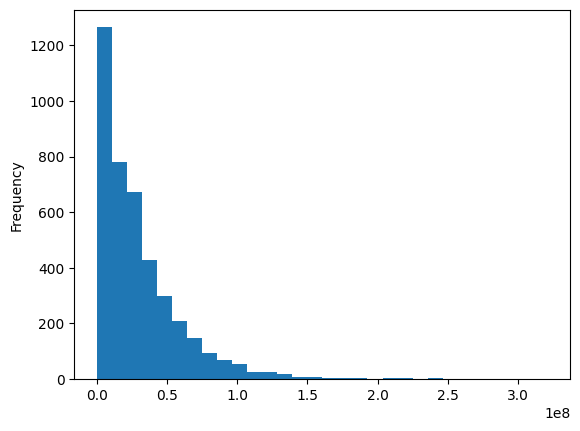

In [57]:
df['Volume'].plot.hist(bins=30) # 直方圖

<Axes: ylabel='Frequency'>

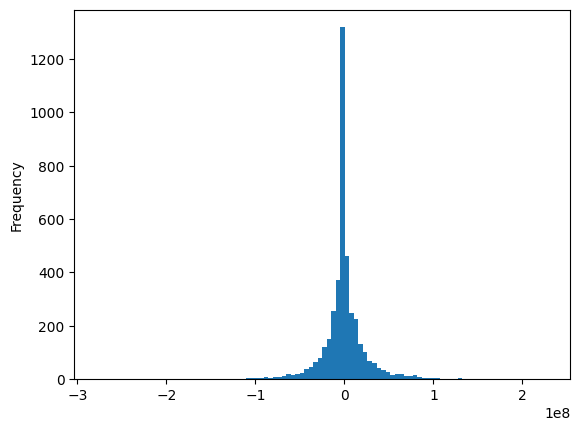

In [58]:
df[df['Volume']!=0]['Volume'].diff().plot.hist(bins=100) # 直方圖

In [59]:
# 欲取得「成交量的增減」與「未來漲跌」是否有關聯性
df_ = df[df['Volume']!=0] # 篩選出成交量不為0的資料

df_['成交量增減'] = df_['Volume'].diff() # 取得成交量的增減
df_['未來報酬'] = df_['Close'].shift(-1) / df_['Close'] - 1 # 取得未來一天的報酬率

C:\Users\TaiLei\AppData\Local\Temp\ipykernel_13892\1339447515.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_['成交量增減'] = df_['Volume'].diff() # 取得成交量的增減
C:\Users\TaiLei\AppData\Local\Temp\ipykernel_13892\1339447515.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_['未來報酬'] = df_['Close'].shift(-1) / df_['Close'] - 1 # 取得未來一天的報酬率


In [60]:
df_

Price,Close,High,Low,Open,Volume,Volume_rank,cut,qcut,中文,成交量增減,未來報酬
Date,,,,,,,,,,,
2009-01-05,23.105860,23.105860,19.304349,22.209157,26338,0.176058,"(20.0, 35.0]","(19.382, 28.544]",我,NaN,-0.000546
2009-01-06,23.093233,23.105863,21.426126,23.105863,24377,0.172430,"(20.0, 35.0]","(19.382, 28.544]",我,-1961.0,-0.119223
2009-01-07,20.339977,22.019715,20.339977,21.912364,16672,0.138331,"(20.0, 35.0]","(19.382, 28.544]",我,-7705.0,-0.063645
2009-01-08,19.045444,21.350348,19.045444,21.217736,31357,0.184764,"(20.0, 35.0]","(19.382, 28.544]",我,14685.0,0.068303
2009-01-09,20.346296,20.535740,20.220000,20.478907,18391,0.148730,"(20.0, 35.0]","(19.382, 28.544]",我,-12966.0,0.061142
2009-01-12,21.590309,21.590309,19.954776,19.973720,13977,0.118259,"(10.0, 20.0]","(19.382, 28.544]",我,-4414.0,-0.044750
2009-01-13,20.624147,21.590312,19.992667,21.590312,11554,0.090931,"(20.0, 35.0]","(19.382, 28.544]",我,-2423.0,0.064605
2009-01-14,21.956572,21.956572,20.516797,20.624148,13520,0.113422,"(20.0, 35.0]","(19.382, 28.544]",我,1966.0,-0.108427
2009-01-15,19.575886,21.956566,19.544312,21.956566,29872,0.182830,"(20.0, 35.0]","(19.382, 28.544]",我,16352.0,-0.032258


C:\Users\TaiLei\AppData\Local\Temp\ipykernel_13892\614907663.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_['成交量的增減'] = df_['Volume'].diff()
C:\Users\TaiLei\AppData\Local\Temp\ipykernel_13892\614907663.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_['未來的報酬率'] = df_['Close'].shift(-1) / df_['Close'] - 1


<Axes: title={'center': '成交量的增減 vs 未來的報酬率'}, xlabel='成交量的增減', ylabel='未來的報酬率'>

c:\Users\TaiLei\OneDrive\Desktop\Code\data_project_course\.venv\Lib\site-packages\IPython\core\events.py:82: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) Microsoft JhengHei.
  func(*args, **kwargs)
c:\Users\TaiLei\OneDrive\Desktop\Code\data_project_course\.venv\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) Microsoft JhengHei.
  fig.canvas.print_figure(bytes_io, **kw)


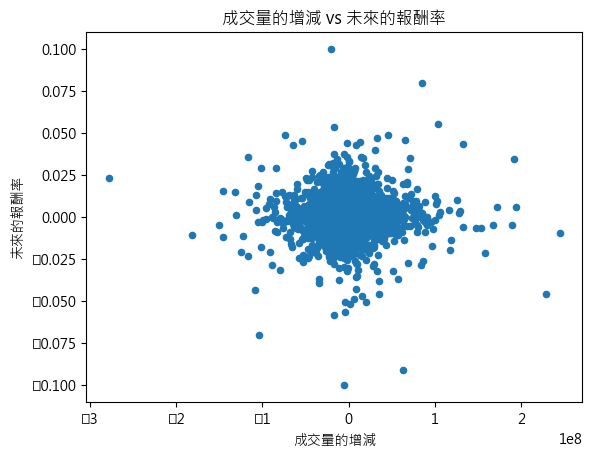

In [ ]:
import matplotlib.pyplot as plt
plt.rcParams['font.sans-serif'] = ['Microsoft JhengHei', 'sans-serif']  # 設定字型以顯示中文

# 成交量的增減 是否會對 未來的報酬率 有影響
df_ = df.drop_duplicates() # 去除重複值
df_['成交量的增減'] = df_['Volume'].diff() # 取得成交量的增減
df_['未來的報酬率'] = df_['Close'].shift(-1) / df_['Close'] - 1 # 取得未來一天的報酬率
df_.loc['2015':].plot.scatter(x='成交量的增減', y='未來的報酬率', title='成交量的增減 vs 未來的報酬率') # 顯示2015年以後的資料

<Axes: xlabel='Date'>

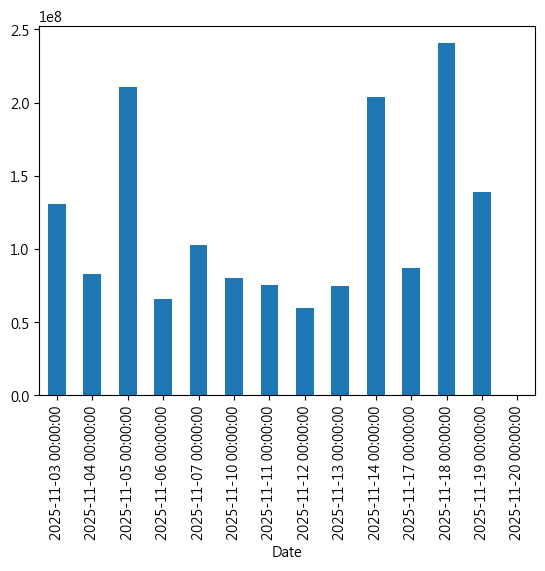

In [68]:
df_.loc['2025-11']['Volume'].plot.bar() # 顯示2025年11月的成交量長條圖
# df_.loc['2025-11']['Volume'].plot.hist() # 顯示2025年11月的成交量直方圖

<Axes: >

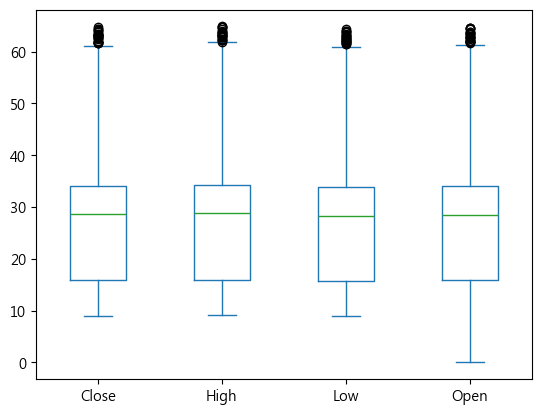

In [71]:
# df[['Close', 'High', 'Low', 'Open']].describe() # 顯示收盤價、最高價、最低價、開盤價的統計數據
df[['Close', 'High', 'Low', 'Open']].plot.box() # 繪製收盤價、最高價、最低價、開盤價的箱型圖

In [78]:
df['Close'].max()

# 群組化 有兩個部分需要思考
# 1. 要拿什麼依據去分群
# 2. 分群後 你想知道甚麼?
# 舉例: 目前有全公司的薪資數據，欲取得不同部門的平均薪資
# 1. 依照部門分群 2. 分群後取得每群的平均薪資
# 實際案例: 欲取得每年的最高收盤價
# 1. 依照年份分群 2. 取得每群的最高收盤價
df.groupby(df.index.year)['Close'].max()

# 欲取得 量增與量減 的 未來報酬率(明天收盤除今天收盤) 平均狀況
df['昨日成交量'] = df['Volume'].shift(1) # 取得昨日的成交量
df['是否量增'] = df['Volume'] > df['昨日成交量'] # 判斷是否量增
df['隔天收盤價'] = df['Close'].shift(-1) # 取得隔天的收盤價
df['未來報酬率'] = df['隔天收盤價'] / df['Close'] - 1 # 計算未來報酬率
df
df.groupby('是否量增')['未來報酬率'].mean()

是否量增
False    0.000356
True     0.000672
Name: 未來報酬率, dtype: float64

C:\Users\TaiLei\AppData\Local\Temp\ipykernel_13892\3844925469.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df['量增減幅度_分群'])['未來報酬率'].mean() # 取得每群的未來報酬率平均值
C:\Users\TaiLei\AppData\Local\Temp\ipykernel_13892\3844925469.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df['量增減幅度_分群'])['未來報酬率'].mean().plot.bar() # 繪製長條圖


<Axes: xlabel='量增減幅度_分群'>

c:\Users\TaiLei\OneDrive\Desktop\Code\data_project_course\.venv\Lib\site-packages\IPython\core\events.py:82: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) Microsoft JhengHei.
  func(*args, **kwargs)
c:\Users\TaiLei\OneDrive\Desktop\Code\data_project_course\.venv\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) Microsoft JhengHei.
  fig.canvas.print_figure(bytes_io, **kw)


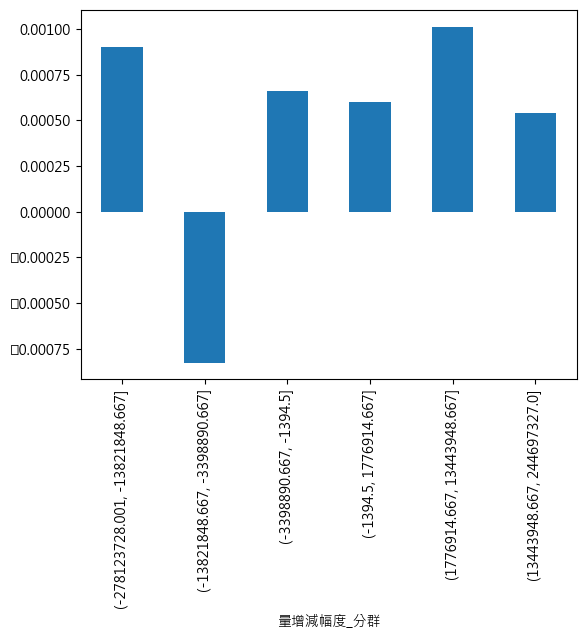

In [82]:
df['量增減幅度'] = df['Volume'].diff() # 取得量增減幅度
df['量增減幅度_分群'] = pd.qcut(df['量增減幅度'], q=6) # 依照量增減幅度分成6等份
df.groupby(df['量增減幅度_分群'])['未來報酬率'].mean() # 取得每群的未來報酬率平均值
df.groupby(df['量增減幅度_分群'])['未來報酬率'].mean().plot.bar() # 繪製長條圖

In [83]:
# 進階應用: 同時取得每群的未來報酬率平均值、中位數、以及該群的最大成交量
df.groupby(df['量增減幅度_分群']).agg({
    '未來報酬率': ['mean', 'median'],
    'Volume': 'max'
})

C:\Users\TaiLei\AppData\Local\Temp\ipykernel_13892\2967909216.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df['量增減幅度_分群']).agg({


Price                               未來報酬率               Volume
                                     mean    median        max
量增減幅度_分群                                                      
(-278123728.001, -13821848.667]  0.000902  0.000504  300494796
(-13821848.667, -3398890.667]   -0.000827  0.000694  116660310
(-3398890.667, -1394.5]          0.000661  0.000449  143974480
(-1394.5, 1776914.667]           0.000597  0.000000  104179588
(1776914.667, 13443948.667]      0.001012  0.000946  111578564
(13443948.667, 244697327.0]      0.000538  0.000509  321307308

In [ ]:
df.groupby(df['量增減幅度_分群'])['未來報酬率'].mean() # 取得每群的未來報酬率平均值
df['依照量增幅度_報酬率'] = df.groupby(df['量增減幅度_分群'])['未來報酬率'].transform('mean') # 將每群的未來報酬率平均值，回填到原本的資料中
df

C:\Users\TaiLei\AppData\Local\Temp\ipykernel_13892\2881088677.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df['量增減幅度_分群'])['未來報酬率'].mean()
C:\Users\TaiLei\AppData\Local\Temp\ipykernel_13892\2881088677.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df['依照量增幅度_報酬率'] = df.groupby(df['量增減幅度_分群'])['未來報酬率'].transform('mean')


Price,Close,High,Low,Open,Volume,Volume_rank,cut,qcut,中文,昨日成交量,是否量增,隔天收盤價,未來報酬率,量增減幅度,量增減幅度_分群,依照量增幅度_報酬率
Date,,,,,,,,,,,,,,,,
2009-01-02,20.756758,20.756758,20.756758,20.756758,0,0.002056,"(20.0, 35.0]","(19.382, 28.544]",我,NaN,False,23.105860,0.113173,NaN,NaN,NaN
2009-01-05,23.105860,23.105860,19.304349,22.209157,26338,0.176058,"(20.0, 35.0]","(19.382, 28.544]",我,0.0,True,23.093233,-0.000546,26338.0,"(-1394.5, 1776914.667]",0.000597
2009-01-06,23.093233,23.105863,21.426126,23.105863,24377,0.172430,"(20.0, 35.0]","(19.382, 28.544]",我,26338.0,False,20.339977,-0.119223,-1961.0,"(-3398890.667, -1394.5]",0.000661
2009-01-07,20.339977,22.019715,20.339977,21.912364,16672,0.138331,"(20.0, 35.0]","(19.382, 28.544]",我,24377.0,False,19.045444,-0.063645,-7705.0,"(-3398890.667, -1394.5]",0.000661
2009-01-08,19.045444,21.350348,19.045444,21.217736,31357,0.184764,"(20.0, 35.0]","(19.382, 28.544]",我,16672.0,True,20.346296,0.068303,14685.0,"(-1394.5, 1776914.667]",0.000597
2009-01-09,20.346296,20.535740,20.220000,20.478907,18391,0.148730,"(20.0, 35.0]","(19.382, 28.544]",我,31357.0,False,21.590309,0.061142,-12966.0,"(-3398890.667, -1394.5]",0.000661
2009-01-12,21.590309,21.590309,19.954776,19.973720,13977,0.118259,"(10.0, 20.0]","(19.382, 28.544]",我,18391.0,False,20.624147,-0.044750,-4414.0,"(-3398890.667, -1394.5]",0.000661
2009-01-13,20.624147,21.590312,19.992667,21.590312,11554,0.090931,"(20.0, 35.0]","(19.382, 28.544]",我,13977.0,False,21.956572,0.064605,-2423.0,"(-3398890.667, -1394.5]",0.000661
2009-01-14,21.956572,21.956572,20.516797,20.624148,13520,0.113422,"(20.0, 35.0]","(19.382, 28.544]",我,11554.0,True,19.575886,-0.108427,1966.0,"(-1394.5, 1776914.667]",0.000597


In [ ]:
# 自訂函數，取得每群的收盤價平均值
def mean_close(group):
    return pd.Series({
        'C_Mean': group['Close'].mean()
    })

df.groupby(df['量增減幅度_分群']).apply(mean_close)

C:\Users\TaiLei\AppData\Local\Temp\ipykernel_13892\3246215546.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df['量增減幅度_分群']).apply(mean_close)
C:\Users\TaiLei\AppData\Local\Temp\ipykernel_13892\3246215546.py:7: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df.groupby(df['量增減幅度_分群']).apply(mean_close)


,C_Mean
量增減幅度_分群,
"(-278123728.001, -13821848.667]",25.089428
"(-13821848.667, -3398890.667]",24.506005
"(-3398890.667, -1394.5]",28.935591
"(-1394.5, 1776914.667]",30.347461
"(1776914.667, 13443948.667]",24.917426
"(13443948.667, 244697327.0]",24.438604


In [ ]:

df.to_excel('20251120_data.xlsx')
data = pd.read_excel('20251120_data.xlsx')

In [92]:
# data.info()
data['Date'] = pd.to_datetime(data['Date'])

In [93]:
data = data.set_index('Date') # 將日期設為索引

In [98]:
data.loc['2025']
data.resample('W')['Close'].last()
data.resample('ME')['Close'].last()
data.resample('MS')['Close'].last()
data.resample('W').agg({
    'Open': 'first',
    'High': 'max',
    'Low': 'min',
    'Close': 'last'
})

,Open,High,Low,Close
Date,,,,
2009-01-04,20.756758,20.756758,20.756758,20.756758
2009-01-11,22.209157,23.105863,19.045444,20.346296
2009-01-18,19.973720,21.956572,18.944408,18.944408
2009-01-25,19.860059,21.299833,18.950722,19.260147
2009-02-01,NaN,NaN,NaN,NaN
2009-02-08,19.196999,21.407187,18.483431,20.333668
2009-02-15,18.912837,22.089184,18.912837,21.015665
2009-02-22,21.015664,22.436495,19.083334,21.685034
2009-03-01,21.685033,21.729237,18.856002,20.870426


In [99]:
data = yf.download("0050.TW", 
                   start='2005-01-01')
data.columns = data.columns.get_level_values(0) # 取消多層欄位名稱

C:\Users\TaiLei\AppData\Local\Temp\ipykernel_13892\3140105988.py:1: FutureWarning: YF.download() has changed argument auto_adjust default to True
  data = yf.download("0050.TW",
[*********************100%***********************]  1 of 1 completed


In [ ]:
data['Close_t0'] = data['Close'] # 本日收盤價
data["Close_t1"] = data['Close'].shift(-1) # 明日收盤價
data['Close_t2'] = data['Close'].shift(-2) # 後天收盤價
data['Close_t-1'] = data['Close'].shift(1) # 昨日收盤價
data['Close_t-2'] = data['Close'].shift(2) # 前天收盤價
data


Price,Close,High,Low,Open,Volume,Close_t0,Close_t1,Close_t2,Close_t-1,Close_t-2
Date,,,,,,,,,,
2009-01-02,20.756754,20.756754,20.756754,20.756754,0,20.756754,23.105865,23.093231,NaN,NaN
2009-01-05,23.105865,23.105865,19.304354,22.209162,26338,23.105865,23.093231,20.339977,20.756754,NaN
2009-01-06,23.093231,23.105861,21.426124,23.105861,24377,23.093231,20.339977,19.045443,23.105865,20.756754
2009-01-07,20.339977,22.019715,20.339977,21.912364,16672,20.339977,19.045443,20.346294,23.093231,23.105865
2009-01-08,19.045443,21.350346,19.045443,21.217734,31357,19.045443,20.346294,21.590309,20.339977,23.093231
2009-01-09,20.346294,20.535738,20.219998,20.478905,18391,20.346294,21.590309,20.624144,19.045443,20.339977
2009-01-12,21.590309,21.590309,19.954776,19.973720,13977,21.590309,20.624144,21.956568,20.346294,19.045443
2009-01-13,20.624144,21.590308,19.992663,21.590308,11554,20.624144,21.956568,19.575886,21.590309,20.346294
2009-01-14,21.956568,21.956568,20.516794,20.624144,13520,21.956568,19.575886,18.944410,20.624144,21.590309


In [108]:
data['3MA'] = data.rolling(3)['Close'].mean() # 3日移動平均
data['20MA'] = data.rolling(20)['Close'].mean() # 20日移動平均
data['60floor'] = data.rolling(60)['Close'].min() # 60日移動平均

<Axes: xlabel='Date'>

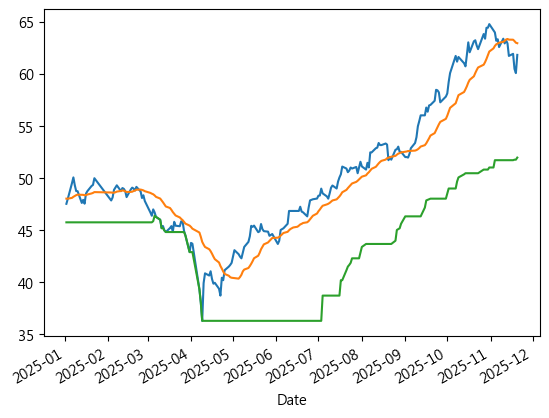

In [109]:
# 將收盤價繪製價格折線圖，並且繪製20日MA，以及60日的價格最低點
data.loc['2025']['Close'].plot()
data.loc['2025']['20MA'].plot()
data.loc['2025']['60floor'].plot()

In [110]:
data1 = yf.download("0050.TW", start='2005-01-01')
data2 = yf.download("0056.TW", start='2005-01-01')

C:\Users\TaiLei\AppData\Local\Temp\ipykernel_13892\4095323826.py:1: FutureWarning: YF.download() has changed argument auto_adjust default to True
  data1 = yf.download("0050.TW", start='2005-01-01')
[*********************100%***********************]  1 of 1 completed
C:\Users\TaiLei\AppData\Local\Temp\ipykernel_13892\4095323826.py:2: FutureWarning: YF.download() has changed argument auto_adjust default to True
  data2 = yf.download("0056.TW", start='2005-01-01')
[*********************100%***********************]  1 of 1 completed


In [111]:
pd.concat([data1, data2], axis=1)

Price,Close,High,Low,Open,Volume,Close,High,Low,Open,Volume
Ticker,0050.TW,0050.TW,0050.TW,0050.TW,0050.TW,0056.TW,0056.TW,0056.TW,0056.TW,0056.TW
Date,,,,,,,,,,
2008-01-02,NaN,NaN,NaN,NaN,NaN,11.544793,11.544793,11.544793,11.544793,0
2008-01-03,NaN,NaN,NaN,NaN,NaN,11.333660,11.333660,11.333660,11.333660,0
2008-01-04,NaN,NaN,NaN,NaN,NaN,11.459437,11.459437,11.459437,11.459437,0
2008-01-07,NaN,NaN,NaN,NaN,NaN,11.162958,11.162958,11.162958,11.162958,0
2008-01-08,NaN,NaN,NaN,NaN,NaN,11.401041,11.401041,11.401041,11.401041,0
2008-01-09,NaN,NaN,NaN,NaN,NaN,11.603189,11.603189,11.603189,11.603189,0
2008-01-10,NaN,NaN,NaN,NaN,NaN,11.558266,11.558266,11.558266,11.558266,0
2008-01-11,NaN,NaN,NaN,NaN,NaN,11.504359,11.504359,11.504359,11.504359,0
